In [1]:
%matplotlib inline

%load_ext autoreload
%autoreload 2

In [2]:
import os

import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import seaborn as sns
sns.set_context('notebook')
import numpy as np
import pandas as pd
from PIL import Image
from astropy.table import Table  # just to read fits

In [3]:
os.chdir('/home/walml/repos/zoobot')

In [4]:
ml_loc = 'results/temp/decals_n2_allq_m0_all_mean.csv'  # load the predictions (only one model here)
ml_raw = pd.read_csv(ml_loc)
print('Galaxies with ML predictions: ' + str(len(ml_raw)))
ml_raw['bar_any_fraction'] = ml_raw['bar_strong_fraction'] + ml_raw['bar_weak_fraction']

Galaxies with ML predictions: 309398


In [5]:
catalog_loc = 'data/decals/decals_master_catalog.csv'
catalog = pd.read_csv(catalog_loc, dtype={'subject_id': str})  # original catalog
catalog['file_loc'] = catalog['local_png_loc'].apply(lambda x: '/media/walml/beta/decals/png_native' + x[35:])


In [6]:
gz2 = pd.read_csv('/media/walml/beta/galaxy_zoo/gz2/subjects/gz2_hart16.csv')

In [7]:
retired = catalog[catalog['smooth-or-featured_total-votes'] > 36]

In [8]:
# gz2.columns.values

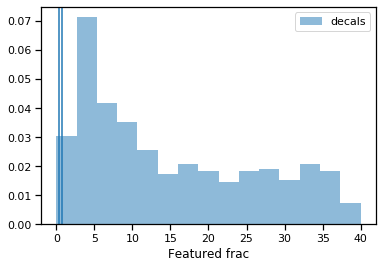

In [9]:
plt.hist(retired['smooth-or-featured_featured-or-disk_fraction'] * 40, alpha=0.5, bins=15, density=True, label='decals')
# plt.hist(gz2['t01_smooth_or_features_a02_features_or_disk_fraction'], alpha=0.5, bins=20, density=True, label='gz2')
plt.legend()
plt.xlabel('Featured frac')
plt.axvline(0.4)  # disks, some of which are featureless
plt.axvline(0.7)  # featured disks, clean sample

In [10]:
# 0.6 for smooth with a few featureless disks
# 0.7 for clean smooth sample

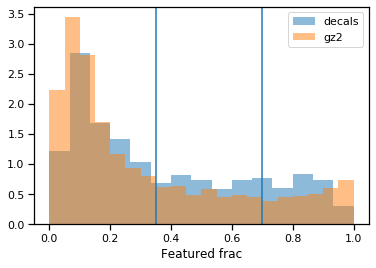

In [11]:
plt.hist(retired['smooth-or-featured_featured-or-disk_fraction'], alpha=0.5, bins=15, density=True, label='decals')
plt.hist(gz2['t01_smooth_or_features_a02_features_or_disk_fraction'], alpha=0.5, bins=20, density=True, label='gz2')
plt.legend()
plt.xlabel('Featured frac')
plt.axvline(0.35)  # disks, some of which are featureless
plt.axvline(0.7)  # featured disks, clean sample

In [12]:
catalog['file_loc']

0         /media/walml/beta/decals/png_native/dr5/J094/J...
1         /media/walml/beta/decals/png_native/dr5/J094/J...
2         /media/walml/beta/decals/png_native/dr5/J094/J...
3         /media/walml/beta/decals/png_native/dr5/J094/J...
4         /media/walml/beta/decals/png_native/dr5/J094/J...
                                ...                        
309393    /media/walml/beta/decals/png_native/dr5/J143/J...
309394    /media/walml/beta/decals/png_native/dr5/J143/J...
309395    /media/walml/beta/decals/png_native/dr5/J230/J...
309396    /media/walml/beta/decals/png_native/dr5/J235/J...
309397    /media/walml/beta/decals/png_native/dr5/J235/J...
Name: file_loc, Length: 309398, dtype: object

In [13]:
ml = pd.merge(ml_raw, catalog[['iauname', 'file_loc']], how='inner', on='iauname')

In [14]:
from zoobot import label_metadata
print(label_metadata.decals_questions)

['smooth-or-featured', 'disk-edge-on', 'has-spiral-arms', 'bar', 'bulge-size', 'how-rounded', 'edge-on-bulge', 'spiral-winding', 'spiral-arm-count', 'merging']


In [15]:
# copied from touch table
def quality_check(df, bin_col, n_bins=10, n_galaxies_per_bin=10):
    df['binned'], bins = pd.cut(df[bin_col], n_bins, labels=False, retbins=True)
    scale = 3
    plt.figure(figsize=(scale * n_galaxies_per_bin, scale * n_bins))
    gs1 = gridspec.GridSpec(n_galaxies_per_bin, n_bins)
    gs1.update(wspace=0.0, hspace=0.0)
    for bin_n in range(n_bins):
        selected_df = df.query('binned == {}'.format(bin_n))
        selected_df = selected_df.sample(len(selected_df))  # shuffle
        for galaxy_n in range(n_galaxies_per_bin):
            if galaxy_n < len(selected_df):
                galaxy = selected_df.iloc[galaxy_n]
                image = Image.open(galaxy['file_loc'])
                ax = plt.subplot(gs1[galaxy_n, bin_n])
                ax.imshow(image)
                ax.text(50, 50, '{:.2f}'.format(galaxy[bin_col]), fontsize=12, color='r')
#                 ax.text(50, 120, 'N = {}'.format(galaxy['total']), fontsize=16, color='r')
                if galaxy_n == 0:
                    ax.text(80, -50, 'Feat: {:.2f} to {:.2f}'.format(bins[bin_n], bins[bin_n + 1]), fontsize=16, color='black')
                ax.axis('off')
#     plt.savefig('touch_table_retirement_{}.pdf'.format(retirement_limit))
    return df

In [16]:
ml.columns.values

array(['iauname', 'smooth-or-featured_smooth_fraction',
       'smooth-or-featured_featured-or-disk_fraction',
       'smooth-or-featured_artifact_fraction',
       'disk-edge-on_yes_fraction', 'disk-edge-on_no_fraction',
       'has-spiral-arms_yes_fraction', 'has-spiral-arms_no_fraction',
       'bar_strong_fraction', 'bar_weak_fraction', 'bar_no_fraction',
       'bulge-size_dominant_fraction', 'bulge-size_large_fraction',
       'bulge-size_moderate_fraction', 'bulge-size_small_fraction',
       'bulge-size_none_fraction', 'how-rounded_round_fraction',
       'how-rounded_in-between_fraction',
       'how-rounded_cigar-shaped_fraction', 'edge-on-bulge_boxy_fraction',
       'edge-on-bulge_none_fraction', 'edge-on-bulge_rounded_fraction',
       'spiral-winding_tight_fraction', 'spiral-winding_medium_fraction',
       'spiral-winding_loose_fraction', 'spiral-arm-count_1_fraction',
       'spiral-arm-count_2_fraction', 'spiral-arm-count_3_fraction',
       'spiral-arm-count_4_fractio

In [17]:
# _ = quality_check(retired[(retired['how-rounded_round_fraction'] < 0.5) & (retired['smooth-or-featured_featured-or-disk_fraction'] < 0.5)], 'smooth-or-featured_featured-or-disk_fraction')

In [18]:
# _ = quality_check(retired[retired['how-rounded_round_fraction'] < 0.5], 'smooth-or-featured_featured-or-disk_fraction')

In [19]:
# _ = quality_check(retired, 'smooth-or-featured_smooth_fraction')

In [20]:
retired.columns.values

array(['iauname', 'nsa_id', 'ra_x', 'dec_x', 'petrotheta', 'petroth50',
       'petroth90', 'redshift_x', 'local_fits_loc', 'local_png_loc',
       'fits_ready', 'fits_filled', 'png_ready', 'nsa_version',
       'file_loc', 'smooth-or-featured_artifact',
       'smooth-or-featured_featured-or-disk', 'smooth-or-featured_smooth',
       'how-rounded_cigar-shaped', 'how-rounded_in-between',
       'how-rounded_round', 'disk-edge-on_no', 'disk-edge-on_yes',
       'edge-on-bulge_boxy', 'edge-on-bulge_none',
       'edge-on-bulge_rounded', 'bar_no', 'bar_weak', 'bar_strong',
       'has-spiral-arms_no', 'has-spiral-arms_yes',
       'spiral-winding_loose', 'spiral-winding_medium',
       'spiral-winding_tight', 'spiral-arm-count_1', 'spiral-arm-count_2',
       'spiral-arm-count_3', 'spiral-arm-count_4',
       'spiral-arm-count_cant-tell', 'spiral-arm-count_more-than-4',
       'bulge-size_none', 'bulge-size_small', 'bulge-size_moderate',
       'bulge-size_large', 'bulge-size_dominant', '

In [21]:
# _ = quality_check(retired[retired['smooth-or-featured_featured-or-disk'] > 20], 'disk-edge-on_yes_fraction')

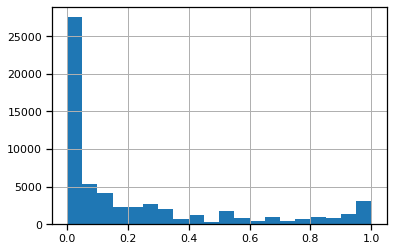

In [22]:
retired['disk-edge-on_yes_fraction'].hist(bins=20)

In [23]:
((retired['smooth-or-featured_featured-or-disk'] > 20) & (retired['disk-edge-on_yes_fraction'] > 0.5)).sum()  # clean sample of edge-on

3816

In [24]:
((retired['smooth-or-featured_featured-or-disk'] > 10) & (retired['disk-edge-on_yes_fraction'] > 0.7)).sum()  # less clean sample of edge-on

5760

In [25]:
retired.columns.values

array(['iauname', 'nsa_id', 'ra_x', 'dec_x', 'petrotheta', 'petroth50',
       'petroth90', 'redshift_x', 'local_fits_loc', 'local_png_loc',
       'fits_ready', 'fits_filled', 'png_ready', 'nsa_version',
       'file_loc', 'smooth-or-featured_artifact',
       'smooth-or-featured_featured-or-disk', 'smooth-or-featured_smooth',
       'how-rounded_cigar-shaped', 'how-rounded_in-between',
       'how-rounded_round', 'disk-edge-on_no', 'disk-edge-on_yes',
       'edge-on-bulge_boxy', 'edge-on-bulge_none',
       'edge-on-bulge_rounded', 'bar_no', 'bar_weak', 'bar_strong',
       'has-spiral-arms_no', 'has-spiral-arms_yes',
       'spiral-winding_loose', 'spiral-winding_medium',
       'spiral-winding_tight', 'spiral-arm-count_1', 'spiral-arm-count_2',
       'spiral-arm-count_3', 'spiral-arm-count_4',
       'spiral-arm-count_cant-tell', 'spiral-arm-count_more-than-4',
       'bulge-size_none', 'bulge-size_small', 'bulge-size_moderate',
       'bulge-size_large', 'bulge-size_dominant', '

In [26]:
featured = retired[retired['disk-edge-on_no'] > 10]
# _ = quality_check(featured, 'bar_strong_fraction')  # there are many bars below 0.7, our cut, but they are more likely to be weak bars. Stick to 0.7 for N=10 cut as well (but will be less clean between stronmg and weak)

In [27]:
featured['bar_any_fraction'] = featured['bar_strong_fraction'] + featured['bar_weak_fraction']

/home/walml/anaconda3/envs/zoobot/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [28]:
edge_20 = featured[featured['disk-edge-on_no'] > 20]

# _ = quality_check(edge_20, 'bar_weak_fraction')  # there are many bars below 0.7, our cut, but they are more likely to be weak bars. Stick to 0.7 for N=10 cut as well (but will be less clean between stronmg and weak)

In [29]:
(featured['bar_any_fraction'] > 0.8).mean()

0.11167369901547117

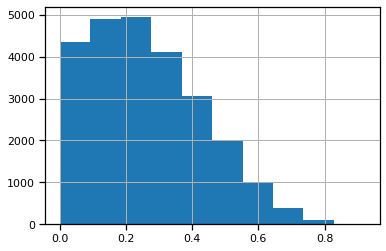

In [30]:
featured['bar_weak_fraction'].hist()

In [31]:
np.percentile(featured['bar_weak_fraction'], 90)

0.5

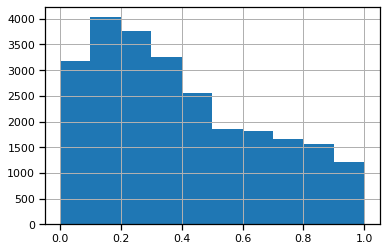

In [32]:
featured['bar_any_fraction'].hist()

In [33]:
np.percentile(featured['bar_any_fraction'], 65)

0.48275862068965525

In [34]:
(featured['bar_strong_fraction'] > 0.8).mean()

0.008479003415712276

In [35]:
featured = featured[featured['disk-edge-on_no'] > 20]
# _ = quality_check(featured, 'bar_any_fraction')  # there are many bars below 0.7, our cut, but they are more likely to be weak bars. Stick to 0.7 for N=10 cut as well (but will be less clean between stronmg and weak)

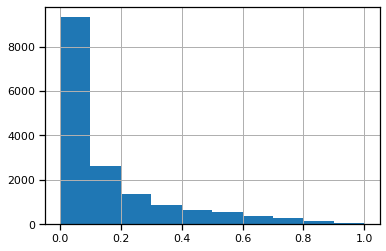

In [36]:
featured['bar_strong_fraction'].hist()

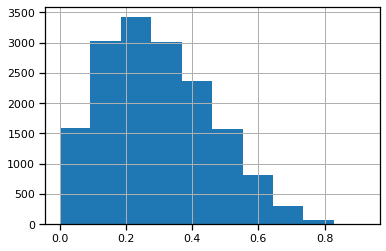

In [37]:
featured['bar_weak_fraction'].hist()

In [38]:
(featured['bar_strong_fraction'] > 0.7).mean()

0.0281159241179015

In [39]:
# around 0.4-0.5 for edge-on disks

In [40]:
# face_on = featured & ml['disk-edge-on_yes_fraction'] < 0.45
# _ = quality_check(ml[face_on], 'has-spiral-arms_yes_fraction')

In [41]:
# spiral arms - somewhere around 0.5

In [42]:
featured['bar_strong_fraction']

0         0.012821
4         0.208333
10        0.000000
14        0.303030
15        0.746479
            ...   
309317    0.030303
309329    0.593220
309334    0.083333
309365    0.272727
309373    0.000000
Name: bar_strong_fraction, Length: 16183, dtype: float64

In [43]:
# redshift effect
# _ = quality_check(ml, 'redshift')

In [44]:
catalog.columns.values

array(['iauname', 'nsa_id', 'ra_x', 'dec_x', 'petrotheta', 'petroth50',
       'petroth90', 'redshift_x', 'local_fits_loc', 'local_png_loc',
       'fits_ready', 'fits_filled', 'png_ready', 'nsa_version',
       'file_loc', 'smooth-or-featured_artifact',
       'smooth-or-featured_featured-or-disk', 'smooth-or-featured_smooth',
       'how-rounded_cigar-shaped', 'how-rounded_in-between',
       'how-rounded_round', 'disk-edge-on_no', 'disk-edge-on_yes',
       'edge-on-bulge_boxy', 'edge-on-bulge_none',
       'edge-on-bulge_rounded', 'bar_no', 'bar_weak', 'bar_strong',
       'has-spiral-arms_no', 'has-spiral-arms_yes',
       'spiral-winding_loose', 'spiral-winding_medium',
       'spiral-winding_tight', 'spiral-arm-count_1', 'spiral-arm-count_2',
       'spiral-arm-count_3', 'spiral-arm-count_4',
       'spiral-arm-count_cant-tell', 'spiral-arm-count_more-than-4',
       'bulge-size_none', 'bulge-size_small', 'bulge-size_moderate',
       'bulge-size_large', 'bulge-size_dominant', '

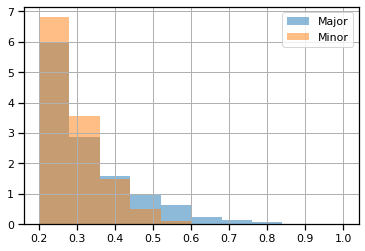

In [45]:
alpha = .5
_, bins = np.histogram(np.linspace(0.2, 1.))
# retired['merging_merger_fraction'].hist(bins=bins, alpha=alpha, label='Merger')
retired['merging_major-disturbance_fraction'].hist(bins=bins, alpha=alpha, label='Major', density=True)
retired['merging_minor-disturbance_fraction'].hist(bins=bins, alpha=alpha, label='Minor', density=True)
# retired['merging_none_fraction'].hist(bins=bins, alpha=alpha, label='None')
plt.legend()

In [46]:
(retired['merging_minor-disturbance_fraction'] > 0.3).sum(), (retired['merging_major-disturbance_fraction'] > 0.6).sum()

(6013, 176)

In [47]:
(retired['merging_minor-disturbance_fraction'] > 0.3).mean(), (retired['merging_major-disturbance_fraction'] > 0.6).mean()

(0.10035214205844557, 0.0029372986865601894)

/home/walml/anaconda3/envs/zoobot/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


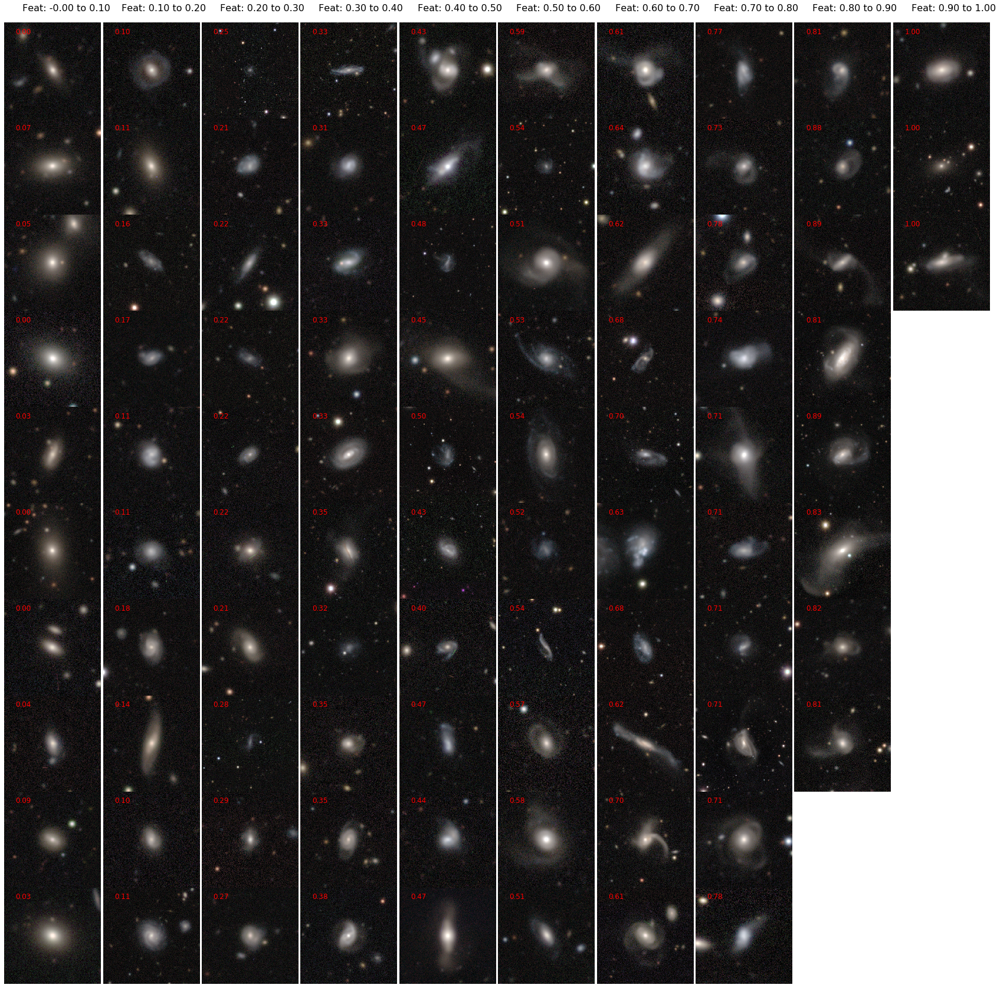

In [48]:

_ = quality_check(retired, 'merging_major-disturbance_fraction')

/home/walml/anaconda3/envs/zoobot/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


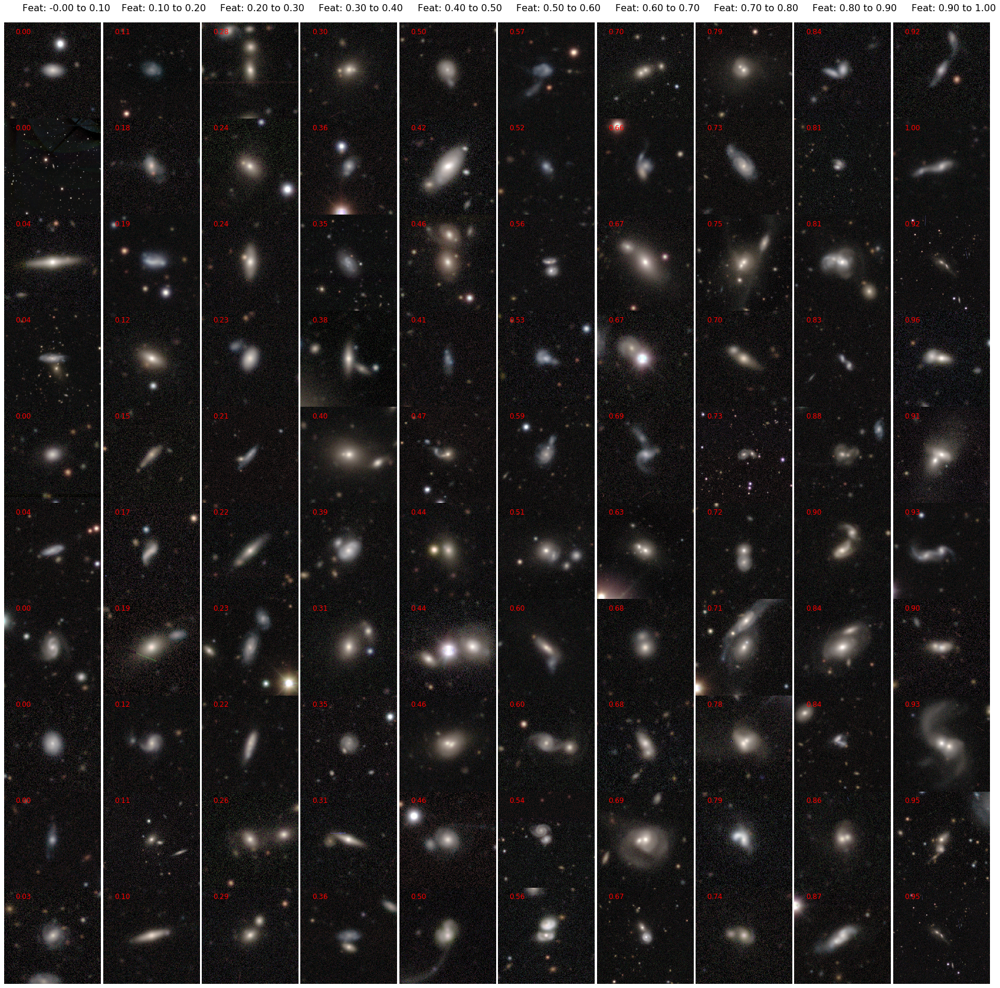

In [51]:

_ = quality_check(retired, 'merging_merger_fraction')

/home/walml/anaconda3/envs/zoobot/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.
/home/walml/anaconda3/envs/zoobot/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


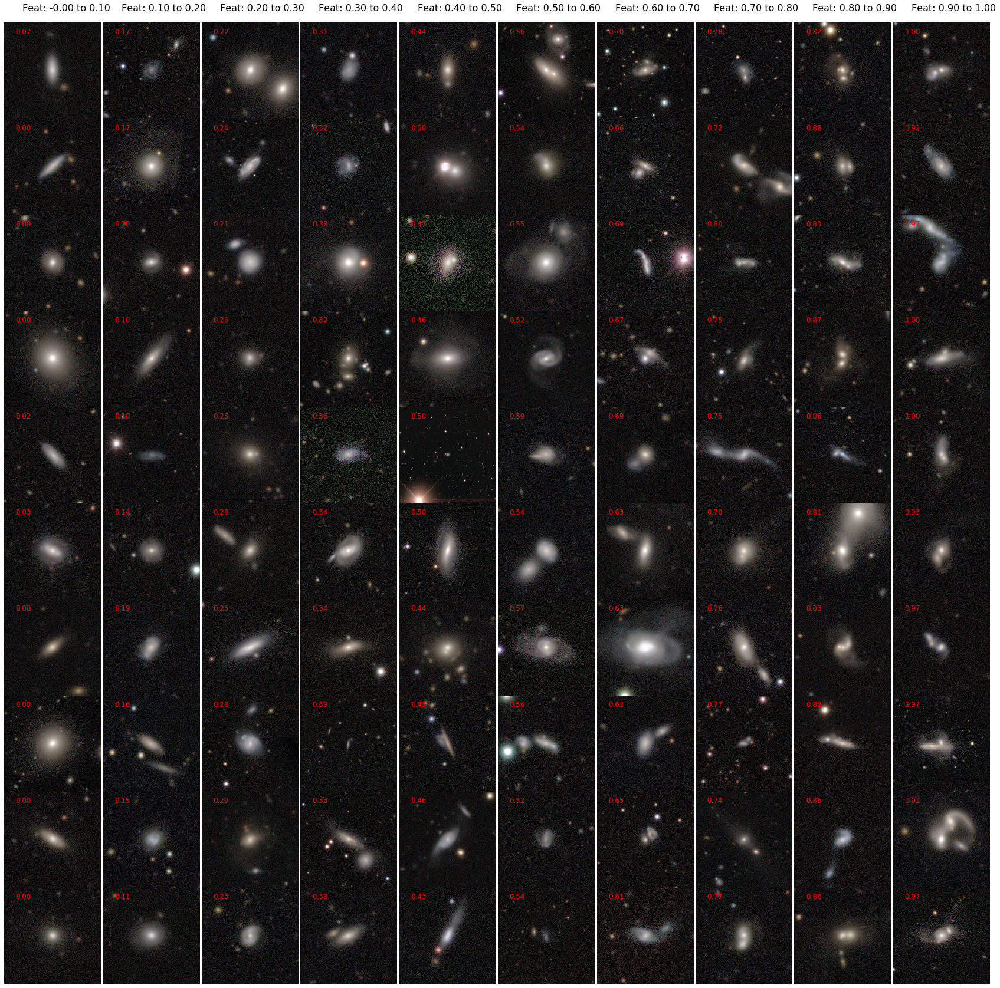

In [52]:
retired['merging_and_disturbance'] = retired['merging_major-disturbance_fraction'] + retired['merging_merger_fraction']

_ = quality_check(retired, 'merging_and_disturbance')

In [50]:
_, bins = np.histogram(np.linspace(0.1, 1.))
retired[low_disturbance]['merging_merger_fraction'].hist(bins=bins)

NameError: name 'low_disturbance' is not defined

In [ ]:
low_minor_disturbance = retired['merging_major-disturbance_fraction'] < 0.1
low_major_disturbance = retired['merging_minor-disturbance_fraction'] < 0.1
low_disturbance = low_minor_disturbance & low_major_disturbance
_ = quality_check(retired[low_disturbance], 'merging_merger_fraction')

In [ ]:
high_minor_disturbance = retired['merging_major-disturbance_fraction'] > 0.2
high_major_disturbance = retired['merging_minor-disturbance_fraction'] > 0.2
high_disturbance = high_minor_disturbance & high_major_disturbance
_ = quality_check(retired[high_disturbance], 'merging_merger_fraction')

In [ ]:
_ = quality_check(retired[~low_disturbance], 'merging_merger_fraction')

In [ ]:

_ = quality_check(retired, 'merging_major-disturbance_fraction')

In [ ]:
_ = quality_check(retired, 'merging_minor-disturbance_fraction')